<a href="https://colab.research.google.com/github/LSDtopotools/lsdtt_notebooks/blob/master/lsdtopotools/basic_examples/geting_segment_bearings.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Getting bearings and angles of channel segment

Last update by Simon M Mudd on 26/06/2023

This notebook shows how to extract the bearings and gradients of all channel segments. A segment is defined as a section of the river network between junctions.

## First install packages in colab

**If you are in the `docker_lsdtt_pytools` docker container, you do not need to do any of this.
The following is for executing this code in the google colab environment only.**

If you are in the docker container you can skip to the **First get data** section.

First we install `lsdviztools`. This will take around a minute. It is important you do this before the `condacolab` step.

In [ ]:
!pip install lsdviztools &> /dev/null

Now we need to install lsdtopotools. We do this using something called `mamba`. To get `mamba` we install something called `condacolab`.

Note that `condacolab` restarts the kernal. Google colab will give you a "this session crashed" message but that is actually just `condacolab` restarting the session.

In [ ]:
!pip install -q condacolab
import condacolab
condacolab.install()

⏬ Downloading https://github.com/conda-forge/miniforge/releases/download/23.1.0-1/Mambaforge-23.1.0-1-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:15
🔁 Restarting kernel...


Now use mamba to install `lsdtopotools`.
This step takes a bit over a minute.

In [ ]:
!mamba install -y lsdtopotools &> /dev/null

This notebooks was made with `lsdtopotools` version 0.9. You can check the version with the following line:

In [ ]:
!lsdtt-basic-metrics -v

|| Welcome to the LSDTopoTools basic metrics tool!     ||
|| This program has a number of options for calculating||
|| simple landscape metrics.                           ||
|| This program was developed by Simon M. Mudd         ||
||  at the University of Edinburgh                     ||
|| If you use these routines please cite:              ||
|| http://doi.org/10.5281/zenodo.4577879               ||
|| If you use the roughness routine please cite:       ||
|| https://www.doi.org/10.5194/esurf-3-483-2015        ||
|| Documentation can be found at:                      ||
|| https://lsdtopotools.github.io/LSDTT_documentation/ ||
|| This is LSDTopoTools2 version                       ||
|| 0.9
|| If the version number has a d at the end it is a    ||
||  development version.                               ||
|| You have called an LSDTopoTools program.            ||
|| Prepare to explore topographic data!                ||
|| You can find some examples of usage here:           ||
|| http

## First get data

We need to get some data to download.

For this example we will work in the Appalacian mountains in West Virginia, since this place has some quite interesting strucutral controls on channels.

We are going to download data using the opentopography scraper that is included with `lsdviztools`. You will need to get an opentopography.org account and copy in your API key.

You can sign up to an opentopography.org account here: https://portal.opentopography.org/myopentopo

In [ ]:
import lsdviztools.lsdbasemaptools as bmt
from lsdviztools.lsdplottingtools import lsdmap_gdalio as gio

# YOU NEED TO PUT YOUR API KEY IN A FILE
your_OT_api_key_file = "my_OT_api_key.txt"

with open(your_OT_api_key_file, 'r') as file:
    print("I am reading you OT API key from the file "+your_OT_api_key_file)
    api_key = file.read().rstrip()
    print("Your api key starts with: "+api_key[0:4])

Dataset_prefix = "WV"
source_name = "COP30"

Xian_DEM = bmt.ot_scraper(source = source_name,
                        lower_left_coordinates = [38.099764296412914, -80.76323669516319],
                        upper_right_coordinates = [39.24905595105265, -79.01641058948063],
                        prefix = Dataset_prefix,
                        api_key_file = your_OT_api_key_file)
Xian_DEM.print_parameters()
Xian_DEM.download_pythonic()
DataDirectory = "./"
Fname = Dataset_prefix+"_"+source_name+".tif"
gio.convert4lsdtt(DataDirectory,Fname)

I am reading you OT API key from the file my_OT_api_key.txt
Your api key starts with: 9515
I am taking your coordinates from the lower left list
I am taking your coordinates from the upper right list
I am reading you OT API key from the file my_OT_api_key.txt
The source is: COP30
The west longitude is: -80.76323669516319
The east longitude is: -79.01641058948063
The south latitude is: 39.24905595105265
The north latitude is: 38.099764296412914
The path is: ./
The prefix is: WV
The resolution is: 30
I am going to download the following for you:
https://portal.opentopography.org/API/globaldem?demtype=COP30&south=38.099764296412914&north=39.24905595105265&west=-80.76323669516319&east=-79.01641058948063&outputFormat=GTiff&API_Key=951579bc84bc38a5894d4d43750aac09
This might take a little while, depending on the size of the file. 
The filename will be:
./WV_COP30.tif
The path and file without path are:
./  WV_COP30.tif
Finished downloading
The projections is:
GEOGCS["WGS 84",DATUM["WGS_1984"

'WV_COP30_UTM.bil'

## Look at the data

Now we can just look at that data. First run a hillshade.

In [ ]:
import lsdviztools.lsdmapwrappers as lsdmw

## Get the basins
lsdtt_parameters = {"write_hillshade" : "true"}
Dataset_prefix = "WV"
source_name = "COP30"
r_prefix = Dataset_prefix+"_"+source_name+"_UTM"
w_prefix = Dataset_prefix+"_"+source_name+"_UTM"

lsdtt_drive = lsdmw.lsdtt_driver(command_line_tool = "lsdtt-basic-metrics",
                                 read_prefix = r_prefix,
                                 write_prefix= w_prefix,
                                 read_path = "./",
                                 write_path = "./",
                                 parameter_dictionary=lsdtt_parameters)
lsdtt_drive.print_parameters()
lsdtt_drive.run_lsdtt_command_line_tool()

The lsdtopotools command line tools available are: 
['lsdtt-basic-metrics', 'lsdtt-channel-extraction', 'lsdtt-chi-mapping', 'lsdtt-cosmo-tool', 'lsdtt-hillslope-channel-coupling', 'lsdtt-valley-metrics']
Testing has been done against lsdtopotools v0.7
The command line tool is: lsdtt-basic-metrics
The driver name is: Test_01
The read path is: ./
The write path is: ./
The read prefix is: WV_COP30_UTM
The write prefix is: WV_COP30_UTM
The parameter dictionary is:
{'write_hillshade': 'true'}
Done writing the driver file
I've finised writing the driver file. Let me run LSDTT for you.


Now plot the data with the next two code blocks.

In [ ]:
%%capture
# Use the capture comment to get rid of all the text
# But it will also not display an inline image
# So you need to call the image from the next line of code
DataDirectory = "./"
Base_file = r_prefix
this_img = lsdmw.SimpleHillshade(DataDirectory,Base_file,cmap="gist_earth",
                                 save_fig=True, size_format="geomorphology",dpi=600)

./WV_COP30_UTM_hillshade.png


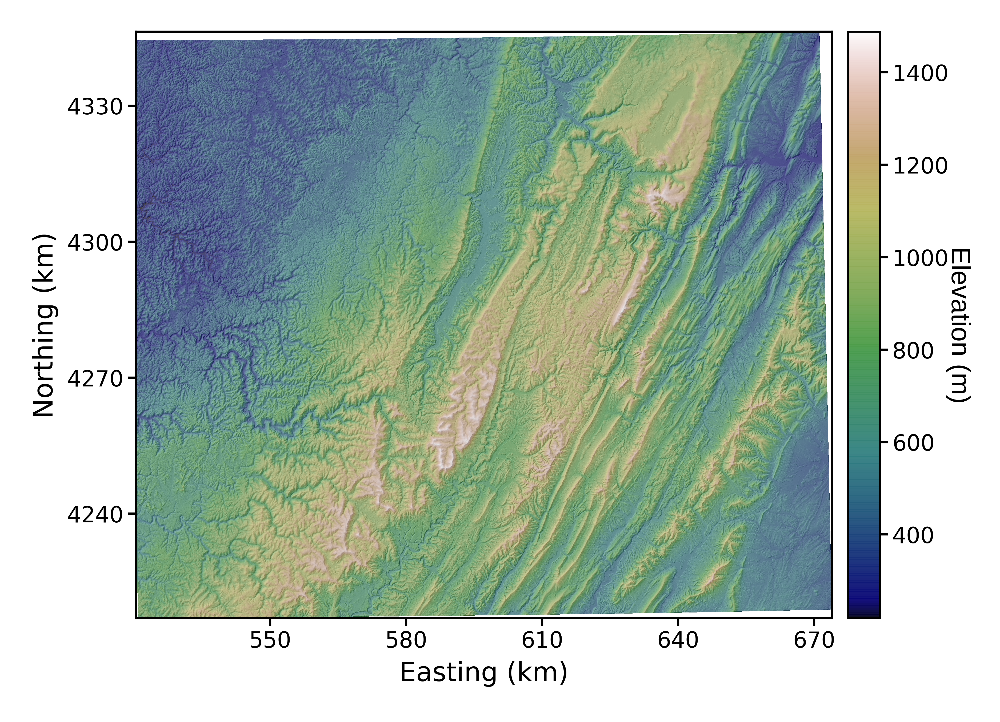

In [ ]:
print(this_img)
from IPython.display import display, Image
display(Image(filename=this_img, width=800))

## Now get the segment information

To get the segment information, we use the switch `print_segment_bearings_and_gradients_to_csv`. This involves extracting a flow network. In order to not overwhelm the computer, we will set a rather large threshold for channel initiation. We set this with the `threshold_contributing_pixels` keyword. We also set a `SA_vertical_interval`. This is inherited from slope-area analysis: it calculates the gradient of the channel after a channel has fallen a vertical interval determined by this parameter (here 10m).  

I also `convert_csv_to_geojson` since this will make it a bit easier to look at the data.

In [ ]:
import lsdviztools.lsdmapwrappers as lsdmw

## Get the basins
lsdtt_parameters = {"print_segment_bearings_and_gradients_to_csv" : "true",
                    "SA_vertical_interval" : "10",
                    "print_channels_to_csv" : "true",
                    "threshold_contributing_pixels" : "5000",
                    "convert_csv_to_geojson" : "true"}

#}
Dataset_prefix = "WV"
source_name = "COP30"
r_prefix = Dataset_prefix+"_"+source_name+"_UTM"
w_prefix = Dataset_prefix+"_"+source_name+"_UTM"

lsdtt_drive = lsdmw.lsdtt_driver(command_line_tool = "lsdtt-basic-metrics",
                                 read_prefix = r_prefix,
                                 write_prefix= w_prefix,
                                 read_path = "./",
                                 write_path = "./",
                                 parameter_dictionary=lsdtt_parameters)
lsdtt_drive.print_parameters()
lsdtt_drive.run_lsdtt_command_line_tool()

The lsdtopotools command line tools available are: 
['lsdtt-basic-metrics', 'lsdtt-channel-extraction', 'lsdtt-chi-mapping', 'lsdtt-cosmo-tool', 'lsdtt-hillslope-channel-coupling', 'lsdtt-valley-metrics']
Testing has been done against lsdtopotools v0.7
The command line tool is: lsdtt-basic-metrics
The driver name is: Test_01
The read path is: ./
The write path is: ./
The read prefix is: WV_COP30_UTM
The write prefix is: WV_COP30_UTM
The parameter dictionary is:
{'print_segment_bearings_and_gradients_to_csv': 'true', 'SA_vertical_interval': '10', 'print_channels_to_csv': 'true', 'threshold_contributing_pixels': '5000', 'convert_csv_to_geojson': 'true'}
Done writing the driver file
I've finised writing the driver file. Let me run LSDTT for you.


This will create a `csv` file that has `segment_bearings` in the filename. We can have a look at this file:

In [ ]:
!ls *segment_bearings*

WV_COP30_UTM_segment_bearings.csv
WV_COP30_UTM_segment_bearings.geojson
WV_COP30_UTM_segment_bearings_vector.geojson


In [ ]:
import pandas as pd
df = pd.read_csv("WV_COP30_UTM_segment_bearings.csv")
df.head()

,latitude,longitude,junction_number,junction_stream_order,junction_drainage_area,segment_bearing_whole_segment,segment_bearing_vertical_interval,gradient_whole_segment,gradient_vertical_interval,x_j,...,z_j,x_pu,y_pu,z_pu,x_vi,y_pi,z_vi,FlowDistance_junction,FlowDistance_pu,FlowDistance_vi
0,39.244508,-79.076784,0,1,4502700.0,125.622940,85.100899,0.014967,0.007061,665966.25,...,373.549072,669776.25,4342943,275.660980,667016.25,667016.25,364.116486,10238.230500,3698.01318,8902.415040
1,39.218909,-79.033005,1,4,205702208.0,29.666716,32.347443,0.003282,0.003329,669806.25,...,275.560333,671156.25,4345283,263.660461,670946.25,670946.25,266.008667,3655.586670,30.00000,786.395996
2,39.246162,-79.268280,3,1,4757400.0,329.036224,329.036224,0.011613,0.011613,649436.25,...,848.814148,649256.25,4345823,844.464417,649256.25,649256.25,844.464417,404.558411,30.00000,30.000000
3,39.242728,-79.840898,5,1,5452200.0,306.573029,329.036224,0.023973,0.037444,600026.25,...,453.714417,599096.25,4345043,420.427643,599936.25,599936.25,446.043854,1418.527950,30.00000,1213.675170
4,39.233036,-79.152865,7,1,4500000.0,199.358978,211.607498,0.018277,0.018052,659426.25,...,561.698364,659036.25,4343153,536.187073,659186.25,659186.25,552.863770,29036.722700,27640.92970,28547.316400


We can also look at the channel network

In [ ]:
import pandas as pd
df = pd.read_csv("WV_COP30_UTM_CN.csv")
df.head()

,latitude,longitude,Junction Index,Stream Order,NI,receiver_NI,receiver_JI
0,39.244508,-79.076784,0,1,11665,11666,1
1,39.244502,-79.076437,0,1,11666,11667,1
2,39.244497,-79.076089,0,1,11667,11668,1
3,39.244491,-79.075742,0,1,11668,10582,1
4,39.244755,-79.075387,0,1,10582,9552,1


## Plot the bearings

First lets see where the channel network is:

In [ ]:
import lsdviztools.lsdmapwrappers as lsdmw
DataDirectory = "./"
Dataset_prefix = "WV"
source_name = "COP30"
r_prefix = Dataset_prefix+"_"+source_name +"_UTM"
Base_file = r_prefix

#%%capture
channel_network_img = lsdmw.PrintPointsOverHillshade(DataDirectory,Base_file, cmap = "jet", points_fname = "WV_COP30_UTM_CN.csv",
                             column_for_plotting = "Stream Order",
                             scale_points = True, column_for_scaling = "Stream Order",
                             scaled_data_in_log = True, max_point_size = 4, min_point_size = 1,
                             size_format = "ESURF",
                             fig_format = "png", dpi = 500, out_fname_prefix = "", save_fig = True)

I am loading the points from: WV_COP30_UTM_CN.csv
I did not find a valid separator. I am assuming the path is ./
The object file prefix is: WV_COP30_UTM_CN
Loading your file from csv
done
I am getting the hillshade
Your colourbar will be located: None
xsize: 5117 and y size: 4313
NoData is: -9999.0
Yoyoyoyo the EPSG is :EPSG:32617
EPSG:32617
The EPSGString is: EPSG:32617
minimum values are x: 520421.0 and y: 4216927.0
I made the ticks.
x labels are: 
['550', '580', '610', '640', '670']
x locations are:
[550000.0, 580000.0, 610000.0, 640000.0, 670000.0]
y labels are: 
['4240', '4270', '4300', '4330']
y locations are:
[4240000.0, 4270000.0, 4300000.0, 4330000.0]
This colourmap is: gray


/usr/local/lib/python3.10/dist-packages/lsdviztools/lsdmapfigure/plottingraster.py:456: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(self.tick_x_labels)
/usr/local/lib/python3.10/dist-packages/lsdviztools/lsdmapfigure/plottingraster.py:457: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(self.tick_y_labels)


The number of axes are: 1
Axes(0,0;1x1)
Axes(0,0;1x1)
Now I'll get some points
I am going to plot some points for you. The EPSG string is:EPSG:32617
pointtools GetUTMEastingNorthing, getting the epsg string: EPSG:32617
WARNING you must have a recent (>=6) version of proj and pyproj (>=2.4) for this to work 
EPSG:32617
I got the easting and northing
I also got the data for scaling, which is in column Stream Order
The size of the array is: 
(198017,)
I am going to convert data to log for point scaling.
I logged (is it a verb?) your scaled data, the minimum is 0.0 and the maximum is 0.6989700043360189 but all the values inferior to -10 will be -10
I am scaling your points for you
max is: 0.6989700043360189 and min is: 0.0
I have got a scaled point array,
I will plot the points now.
The colourmap is: jet
I will colour by the points
The aspect ratio is: 1.1864131694875957
I need to adjust the spacing of the colourbar.
The cbar characters are: 0 and the cbar text width is: 0.4
No colourbar
T

Now lets try to plot:

./WV_COP30_UTM_channels_with_basins.png


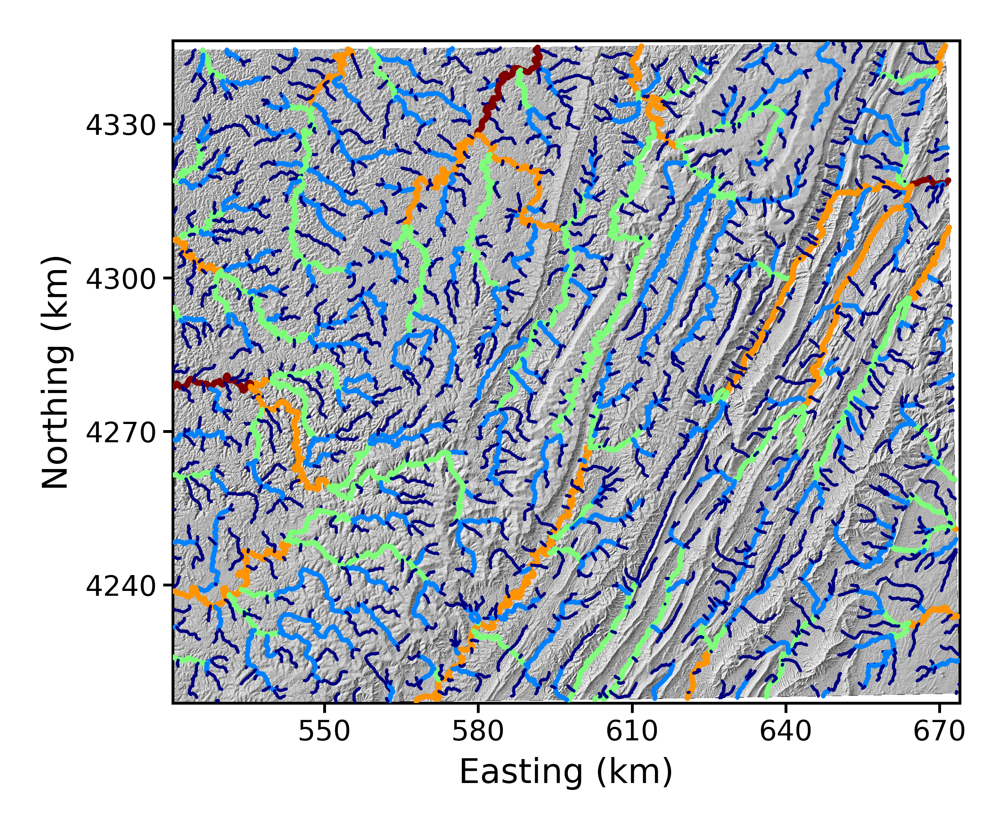

In [ ]:
print(channel_network_img)
from IPython.display import display, Image
display(Image(filename=channel_network_img, width=800))

And now the channel bearings:

In [ ]:
import lsdviztools.lsdmapwrappers as lsdmw
DataDirectory = "./"
Dataset_prefix = "WV"
source_name = "COP30"
r_prefix = Dataset_prefix+"_"+source_name +"_UTM"
Base_file = r_prefix

#%%capture
channel_bearing_img = lsdmw.PrintPointsOverHillshade(DataDirectory,Base_file, cmap = "jet", points_fname = "WV_COP30_UTM_segment_bearings.csv",
                             column_for_plotting = "segment_bearing_whole_segment",
                             scale_points = True, column_for_scaling = "Stream Order",
                             scaled_data_in_log = True, max_point_size = 4, min_point_size = 1,
                             size_format = "ESURF",
                             fig_format = "png", dpi = 500, out_fname_prefix = "", save_fig = True)

I am loading the points from: WV_COP30_UTM_segment_bearings.csv
I did not find a valid separator. I am assuming the path is ./
The object file prefix is: WV_COP30_UTM_segment_bearings
Loading your file from csv
done
I am getting the hillshade
Your colourbar will be located: None
xsize: 5117 and y size: 4313
NoData is: -9999.0
Yoyoyoyo the EPSG is :EPSG:32617
EPSG:32617
The EPSGString is: EPSG:32617
minimum values are x: 520421.0 and y: 4216927.0
I made the ticks.
x labels are: 
['550', '580', '610', '640', '670']
x locations are:
[550000.0, 580000.0, 610000.0, 640000.0, 670000.0]
y labels are: 
['4240', '4270', '4300', '4330']
y locations are:
[4240000.0, 4270000.0, 4300000.0, 4330000.0]
This colourmap is: gray


/usr/local/lib/python3.10/dist-packages/lsdviztools/lsdmapfigure/plottingraster.py:456: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(self.tick_x_labels)
/usr/local/lib/python3.10/dist-packages/lsdviztools/lsdmapfigure/plottingraster.py:457: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(self.tick_y_labels)


The number of axes are: 1
Axes(0,0;1x1)
Axes(0,0;1x1)
Now I'll get some points
I am going to plot some points for you. The EPSG string is:EPSG:32617
pointtools GetUTMEastingNorthing, getting the epsg string: EPSG:32617
WARNING you must have a recent (>=6) version of proj and pyproj (>=2.4) for this to work 
EPSG:32617
I got the easting and northing
The data Stream Order is not one of the data elements in this point data
I also got the data for scaling, which is in column Stream Order
The size of the array is: 
(0,)
I am going to convert data to log for point scaling.
I am scaling your points for you
There doesn't seem to be any scaling data. Reverting to manual size.
I will plot the points now.
The colourmap is: jet
I will colour by the points
The aspect ratio is: 1.1864131694875957
I need to adjust the spacing of the colourbar.
The cbar characters are: 0 and the cbar text width is: 0.4
No colourbar
The figure size is: 
[4.92126, 4.112994797733046]
Map axes are:
[0.1727199944729602, 0.

./WV_COP30_UTM_channels_with_basins.png


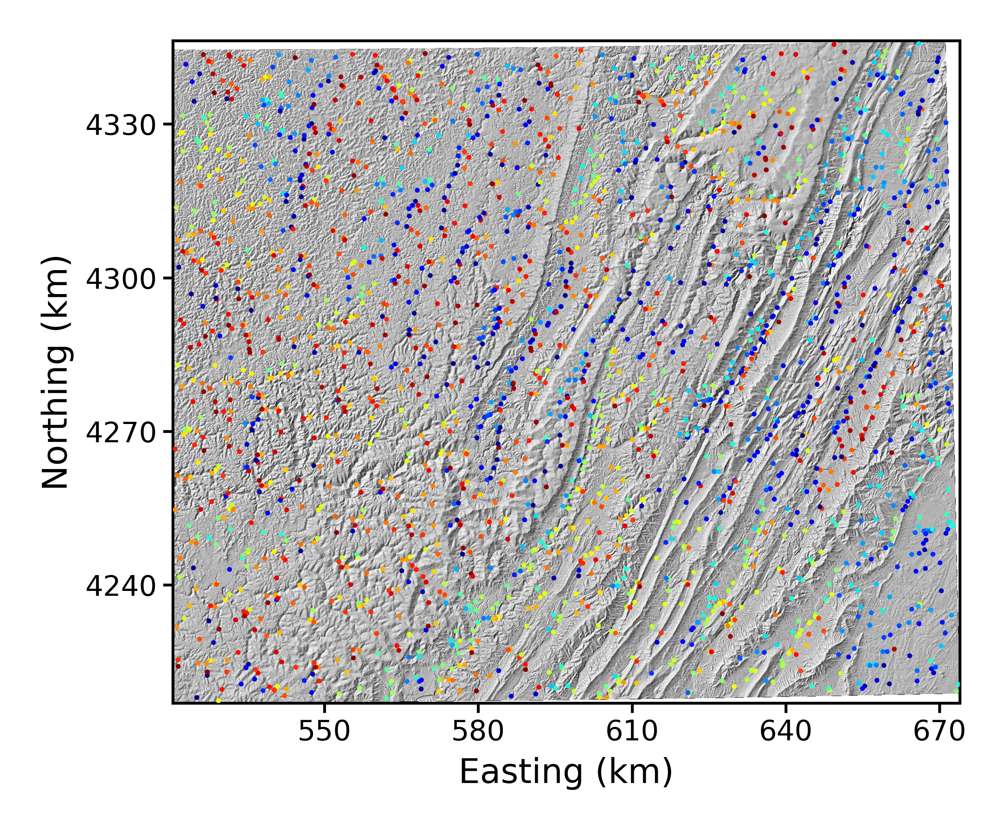

In [ ]:
print(channel_bearing_img)
from IPython.display import display, Image
display(Image(filename=channel_bearing_img, width=800))